# Распознавание объектов

Распознавание объектов на картинках является одной из самых распространённых проблем машинного обучения. Сегодня мы познакомимся с очень популярной моделью — YOLO.

YOLO (You Only Look Once) — это семейство моделей, которые стали популярны благодаря легковесности и качеству предсказаний. Такие характеристики позволяют использовать YOLO для задач распознавания объектов в реальном времени и на портативных устройствах.

Что делает YOLO, когда учится на данных (простыми словами):

1: Обычно картинки приводят под размер 416x416 перед началом обучения нейронной сети.

2: Делим картинку (пока что мысленно) на клетки. В YOLOv3-4 принято делить на клетки размером 13x13 (о различных скейлах поговорим чуть позже, чтобы было понятнее).

![alternative_text](https://hsto.org/r/w1560/webt/ci/lq/ff/cilqffcvpw7rycahb_j5hwts4as.png)

Теперь фокусируемся на эти клеточках, на которые мы разделили картинку/кадр. Такие клетки, которые называются grid cells, лежат в основе идеи YOLO. Каждая клетка является «якорем», к которому прикрепляются bounding boxes. То есть, вокруг клетки рисуются несколько прямоугольников для определения объекта (поскольку непонятно, какой формы прямоугольник будет наиболее подходящим, их рисуют сразу несколько и разных форм) и его позиции, ширина и высота вычисляются относительно центра этой клетки.

![alternative_text](https://hsto.org/r/w1560/webt/0f/_-/1w/0f_-1wtt4qkwxr6bww4hpysnuwc.jpeg)

3: Картинка из датасета прогоняется через нашу нейронную сеть. (Заметим, что кроме картинки в тренировочном датасете у нас должны быть определены позиции и размеры настоящих bounding boxes для объектов, которые есть на ней. Это называется «аннотация» и делается это в основном вручную.)

Внутри у YOLO достаточно сложная структура, которая на выходе нам выдает:
1. координаты полученных «объектов»;
2. уверенность (от 0 до 1) в том, что это за объект.

![alternative_text](https://hsto.org/r/w1560/webt/bj/ld/wm/bjldwmnqycbox81gunaedgon4go.jpeg)

Сегодня мы посмотрим, как работают такие модели.

Загрузим нашу модель из репозитория [Ultralytics/yolov5](https://github.com/ultralytics/yolov5).

In [1]:
# если будете запускать ноутбук - раскоментарьте строки ниже
# 
# !git clone https://github.com/ultralytics/yolov5  # clone
# %cd yolov5
# %pip install -qr requirements.txt  # install

In [2]:
# !pip install opencv-python

In [3]:
import torch
print(torch.__version__)

2.2.0+cu121


In [4]:
import os

import cv2
import torch
from PIL import Image

import matplotlib as plt

Загрузим модель из torch.hub

In [5]:
model = torch.hub.load('ultralytics/yolov5', 'yolov5s');

Using cache found in Z:\python-datasets\cache\torch\hub\ultralytics_yolov5_master
YOLOv5  2024-7-14 Python-3.11.5 torch-2.2.0+cu121 CUDA:0 (NVIDIA GeForce RTX 3090, 24575MiB)

100%|█████████████████████████████████████████████████████████████████████████████| 14.1M/14.1M [00:02<00:00, 6.97MB/s]

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
Adding AutoShape... 


В папке images находятся изображения, которые мы будем давать нашей модели для детекции.

In [6]:
def get_path_names(folder):
    # list files in img directory
    files = os.listdir(folder)
    images = []
    for file in files:
        # make sure file is an image
        if file.endswith(('.jpg', '.png', 'jpeg')) and not file.startswith('._'):
            img_path = os.path.join(folder, file)
            images.append(img_path)
    
    return images


# Путь к каталогу с датасетами
path_to_dataset = './datasets'

In [7]:
images = get_path_names(os.path.join(path_to_dataset, 'images', 'good'))
images

['./datasets\\images\\good\\bus.jpg',
 './datasets\\images\\good\\people.jpeg',
 './datasets\\images\\good\\zidane.jpg']

Посмотрим, как отработает наша модель на этих картинках.

In [8]:
images_loaded = []
for image_filepath in images:
    image = cv2.imread(image_filepath)
    image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
    images_loaded.append(image)

In [9]:
results = model(images_loaded, size=640)

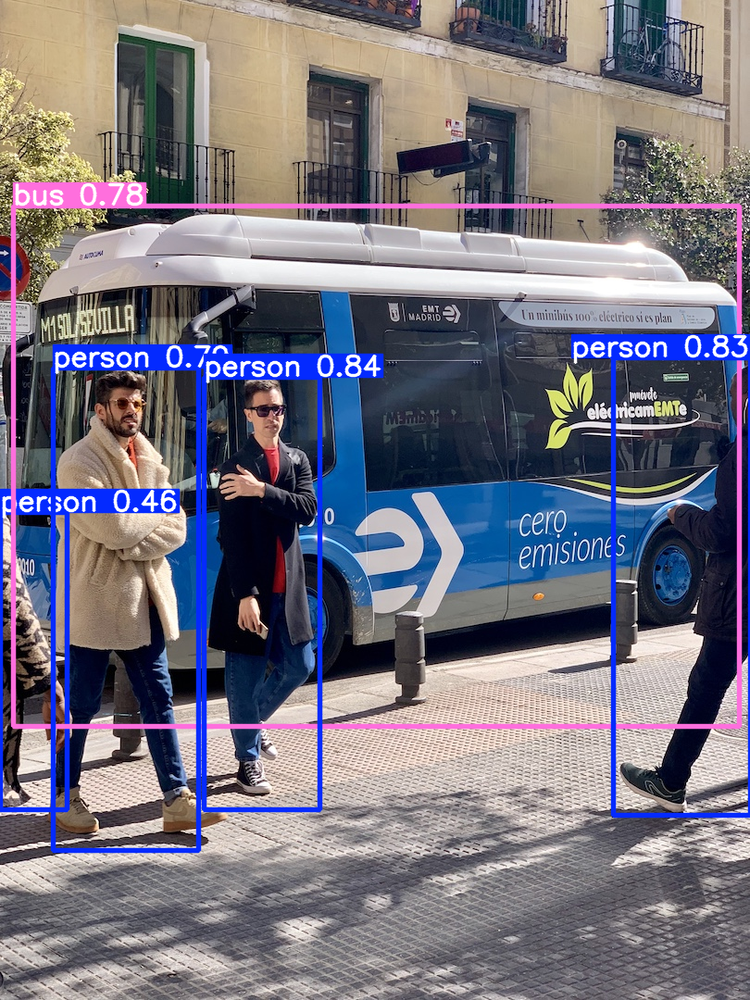

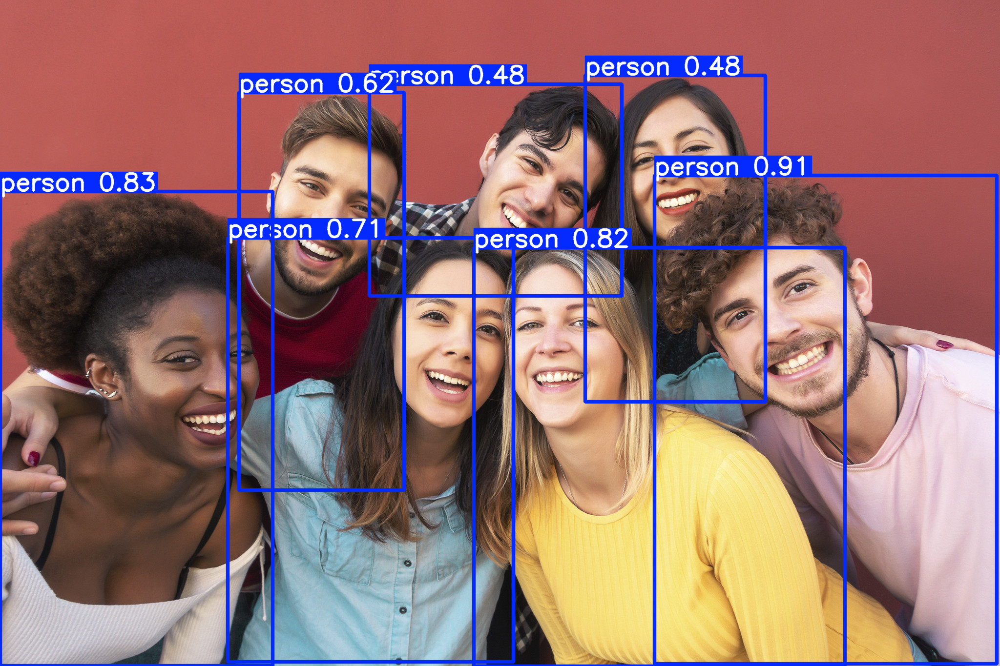

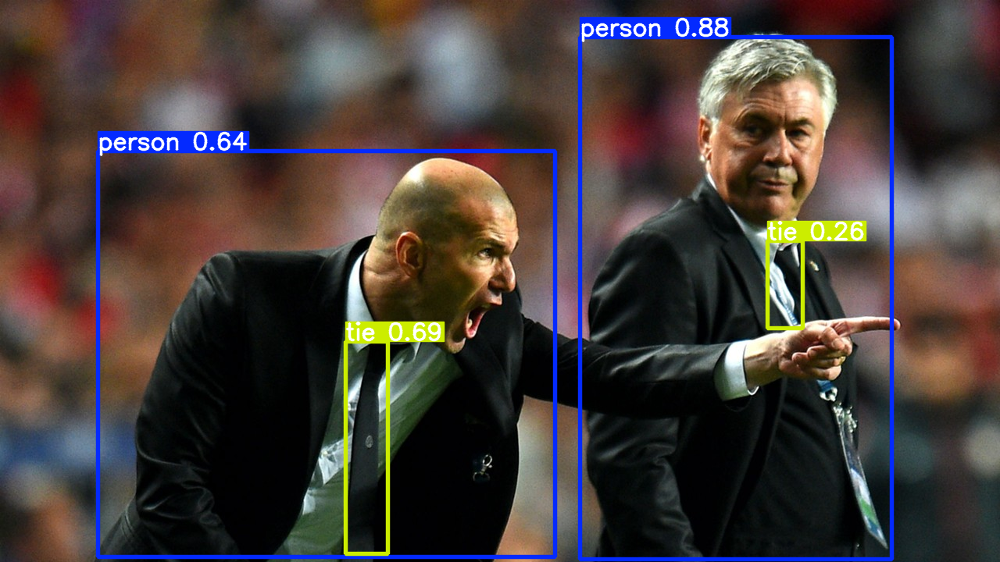

In [10]:
results.show()

Если же мы выведем результаты нашей модели, мы увидим, что в ней находятся координаты рамок, в которых модель нашла объект, вычисленная вероятность, соответствующая этому объекту и класс(тип объекта).

In [11]:
results.print()

image 1/3: 1080x810 4 persons, 1 bus
image 2/3: 1365x2048 7 persons
image 3/3: 720x1280 2 persons, 2 ties
Speed: 3.3ms pre-process, 38.0ms inference, 43.3ms NMS per image at shape (3, 3, 640, 640)


In [12]:
results.xyxy[0]
results.pandas().xyxy[0]

,xmin,ymin,xmax,ymax,confidence,class,name
0,220.870956,407.428009,345.729950,874.672729,0.835114,0,person
1,662.581543,386.182648,810.000000,880.340637,0.828962,0,person
2,57.569756,397.349915,214.814346,918.240906,0.785558,0,person
3,14.702359,222.181992,798.358459,784.921204,0.781569,5,bus
4,0.000000,553.398682,72.455307,874.661377,0.464463,0,person


In [13]:
results.xyxy[1]
results.pandas().xyxy[1]

,xmin,ymin,xmax,ymax,confidence,class,name
0,1340.194946,359.920563,2041.370728,1360.177979,0.909652,0,person
1,0.000000,392.639862,558.361572,1364.410156,0.831504,0,person
2,970.641418,507.794250,1730.633057,1365.000000,0.824234,0,person
3,466.655762,487.116028,1051.488159,1356.146851,0.714903,0,person
4,489.376190,189.551132,827.996887,1004.972839,0.618170,0,person
5,1198.610840,154.685455,1567.406738,823.065125,0.481248,0,person
6,756.977478,172.778183,1273.778809,606.904114,0.476523,0,person


Как у любой модели, у YOLO есть свои ограничения.
Взгляните на следующий пример:

In [14]:
images = get_path_names(os.path.join(path_to_dataset, 'images', 'bad'))
images

['./datasets\\images\\bad\\lots_of_people.jpeg',
 './datasets\\images\\bad\\up.jpeg']

In [15]:
images_loaded = []
for image_filepath in images:
    image = cv2.imread(image_filepath)
    image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
    images_loaded.append(image)

In [16]:
results = model(images_loaded, size=640)

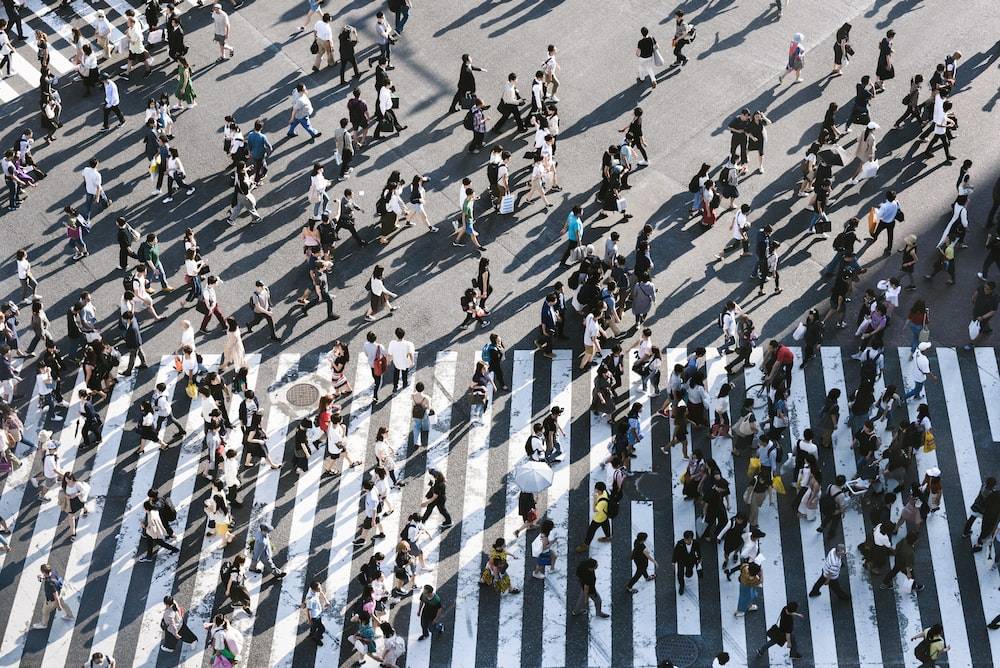

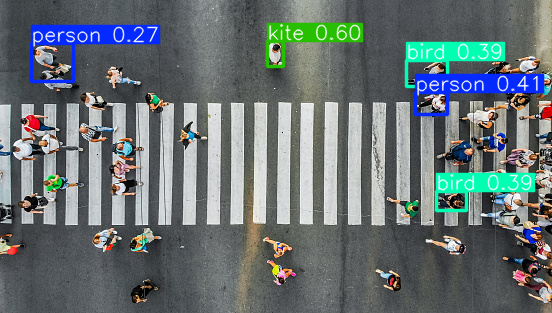

In [17]:
results.show()

Как видишь, на этих картинках результаты достаточно скудные. Как думаешь, почему?

##### Ответ: Вид с необычного ракурса и модели не давали таких изображений при обучении.

# Задание 2

1. В папку `datasets/images/task-2` добавь изображения, на которых ты бы хотел протестировать работу алгоритма. Алгоритм обучен на датасете [COCO](https://cocodataset.org/#explore).
2. Протестируй модель на выбранных изображениях. Проанализируй результаты модели.
3. Если на каких-то изображениях модель продемонстрировала неточные предсказания, то опиши возможную причину.

In [18]:
task2 = get_path_names(os.path.join(path_to_dataset, 'images', 'task-2'))
task2

['./datasets\\images\\task-2\\army2019_calendar_06-jun-min.jpg',
 './datasets\\images\\task-2\\photo_2024-07-08_18-50-27.jpg',
 './datasets\\images\\task-2\\photo_2024-07-10_17-01-20.jpg']

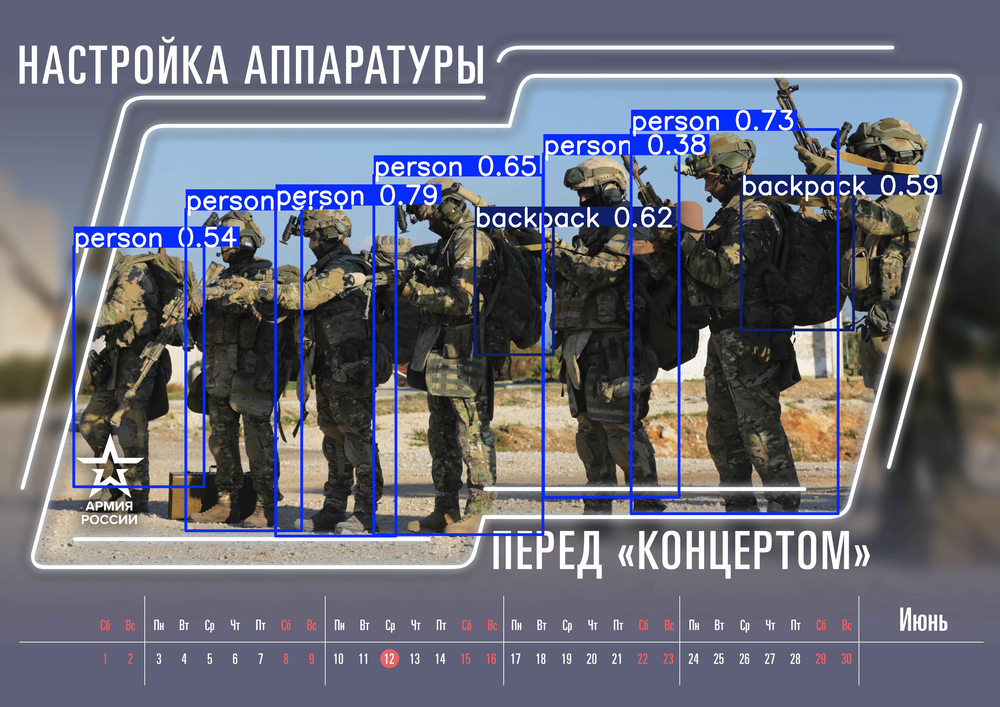

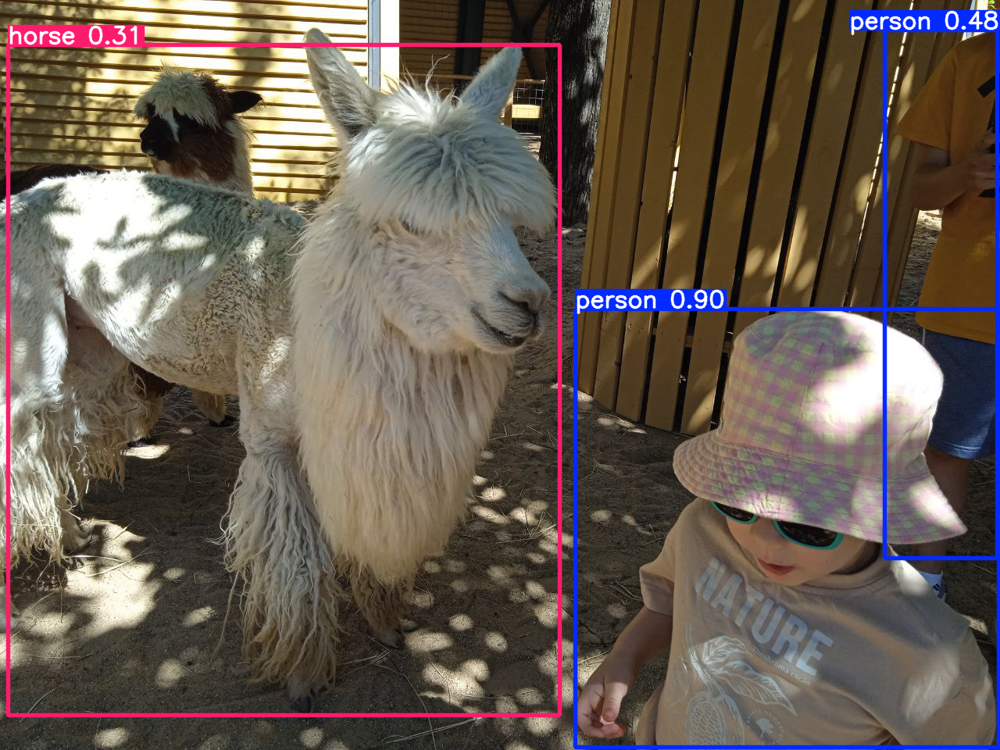

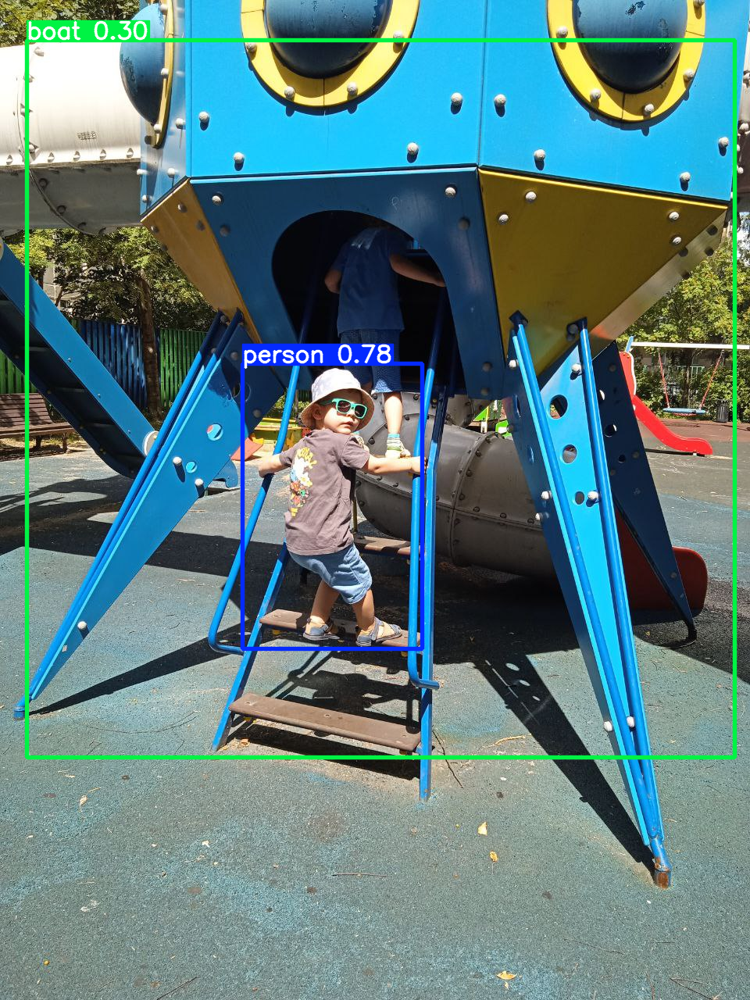

In [19]:
images_loaded = []
for image_filepath in task2:
    image = cv2.imread(image_filepath)
    image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
    images_loaded.append(image)

results = model(images_loaded, size=640)
results.show()

1. На первой картинке правильно определила 6 человек из 7, хотя у седьмого видна голова и половина туловища. Также определено 2 рюкзака, но на самом деле рюкзаки есть у всех. 
2. На второй картинке правильно определила двух людей и ламу, но не смогла определить вторую ламу, т.к. она частично закрыта ламой на переднем плане.
3. На третьей картинке правильно определила одного ребенка и корабль, но не нашла второго ребенка, возможно из-за того, что голова находится в люке в тени и большая часть головы не видна.